In [1]:
# Importamos el módulo Path de la biblioteca pathlib, que proporciona clases para trabajar con rutas del sistema de archivos de una manera más sencilla y eficiente.
from pathlib import Path

# Importamos la biblioteca pandas con el alias 'pd'. Pandas es una biblioteca esencial para el análisis y manipulación de datos en Python.
import pandas as pd

# Importamos el módulo tarfile, que permite leer y escribir archivos tar, que son archivos comprimidos utilizados frecuentemente para distribuir paquetes de software.
import tarfile

# Importamos el módulo urllib.request, que nos permite abrir y leer URLs. Esto es útil para descargar datos desde la web.
import urllib.request


# Descargar la Data

In [2]:
# Definimos una función para cargar los datos de vivienda.
def load_housing_data():
    """
    Descarga y extrae los datos de vivienda si no están disponibles localmente,
    y luego carga los datos en un DataFrame de pandas.

    Returns:
        pd.DataFrame: Un DataFrame de pandas que contiene los datos de vivienda.
    """
    # Especificamos la ruta del archivo tarball que contiene los datos de vivienda.
    tarball_path = Path("datasets/housing.tgz")
    
    # Verificamos si el archivo tarball ya existe en el sistema de archivos.
    if not tarball_path.is_file():
        # Si no existe, creamos el directorio 'datasets' si aún no está creado.
        Path("datasets").mkdir(parents=True, exist_ok=True)
        
        # Especificamos la URL desde donde se descargará el archivo tarball.
        url = "https://github.com/ageron/data/raw/main/housing.tgz"
        
        # Descargamos el archivo tarball desde la URL especificada y lo guardamos en la ruta especificada.
        urllib.request.urlretrieve(url, tarball_path)
        
        # Abrimos el archivo tarball y extraemos su contenido en el directorio 'datasets'.
        with tarfile.open(tarball_path) as housing_tarball:
            housing_tarball.extractall(path="datasets")
    
    # Cargamos el archivo CSV que contiene los datos de vivienda en un DataFrame de pandas y lo retornamos.
    return pd.read_csv(Path("datasets/housing/housing.csv"))

# Llamamos a la función load_housing_data para cargar los datos de vivienda en un DataFrame.
housing = load_housing_data()


# Echar un vistazo rápido a la estructura de datos

In [3]:
housing.head()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity
0,-122.23,37.88,41.0,880.0,129.0,322.0,126.0,8.3252,452600.0,NEAR BAY
1,-122.22,37.86,21.0,7099.0,1106.0,2401.0,1138.0,8.3014,358500.0,NEAR BAY
2,-122.24,37.85,52.0,1467.0,190.0,496.0,177.0,7.2574,352100.0,NEAR BAY
3,-122.25,37.85,52.0,1274.0,235.0,558.0,219.0,5.6431,341300.0,NEAR BAY
4,-122.25,37.85,52.0,1627.0,280.0,565.0,259.0,3.8462,342200.0,NEAR BAY


In [4]:
housing.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20640 entries, 0 to 20639
Data columns (total 10 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   longitude           20640 non-null  float64
 1   latitude            20640 non-null  float64
 2   housing_median_age  20640 non-null  float64
 3   total_rooms         20640 non-null  float64
 4   total_bedrooms      20433 non-null  float64
 5   population          20640 non-null  float64
 6   households          20640 non-null  float64
 7   median_income       20640 non-null  float64
 8   median_house_value  20640 non-null  float64
 9   ocean_proximity     20640 non-null  object 
dtypes: float64(9), object(1)
memory usage: 1.6+ MB


In [5]:
housing["ocean_proximity"].value_counts()

ocean_proximity
<1H OCEAN     9136
INLAND        6551
NEAR OCEAN    2658
NEAR BAY      2290
ISLAND           5
Name: count, dtype: int64

In [6]:
housing.describe()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value
count,20640.000000,20640.000000,20640.000000,20640.000000,20433.000000,20640.000000,20640.000000,20640.000000,20640.000000
mean,-119.569704,35.631861,28.639486,2635.763081,537.870553,1425.476744,499.539680,3.870671,206855.816909
std,2.003532,2.135952,12.585558,2181.615252,421.385070,1132.462122,382.329753,1.899822,115395.615874
min,-124.350000,32.540000,1.000000,2.000000,1.000000,3.000000,1.000000,0.499900,14999.000000
25%,-121.800000,33.930000,18.000000,1447.750000,296.000000,787.000000,280.000000,2.563400,119600.000000
50%,-118.490000,34.260000,29.000000,2127.000000,435.000000,1166.000000,409.000000,3.534800,179700.000000
75%,-118.010000,37.710000,37.000000,3148.000000,647.000000,1725.000000,605.000000,4.743250,264725.000000
max,-114.310000,41.950000,52.000000,39320.000000,6445.000000,35682.000000,6082.000000,15.000100,500001.000000


----------------------------------------

# Crear una columna "id"

In [7]:
import hashlib

def create_hash(data_original):
    """
    Esta función toma un DataFrame llamado 'housing', reinicia el índice, 
    crea una columna 'id' utilizando un hash basado en las columnas 'longitude', 
    'latitude' y el índice de la fila, y devuelve el DataFrame actualizado 
    con la columna 'id' como la primera columna.
    
    Args:
    data_original (pd.DataFrame): El DataFrame original con los datos de vivienda.

    Returns:
    pd.DataFrame: El DataFrame actualizado con la columna 'id' como la primera columna.
    """
    # Guardar el DataFrame 'housing' en otra variable
    data_entrenamiento_validacion_prueba = data_original.copy()
    
    # Reiniciar el índice
    data_entrenamiento_validacion_prueba.reset_index(drop=True, inplace=True)
    
    # Función para crear un hash basado en 'longitude', 'latitude' y el índice de la fila
    def create_hash_value(row):
        unique_string = f"{row.name}_{row['longitude']}_{row['latitude']}"
        return hashlib.md5(unique_string.encode()).hexdigest()
    
    # Generar la columna 'id' usando el hash
    data_entrenamiento_validacion_prueba['id'] = data_entrenamiento_validacion_prueba.apply(create_hash_value, axis=1)
    
    # Reordenar las columnas para que 'id' sea la primera
    cols = ['id'] + [col for col in data_entrenamiento_validacion_prueba.columns if col != 'id']
    data_entrenamiento_validacion_prueba = data_entrenamiento_validacion_prueba[cols]
    
    return data_entrenamiento_validacion_prueba

In [8]:
# Ejemplo de uso
data_entrenamiento_validacion_prueba = create_hash(housing)

data_entrenamiento_validacion_prueba.head()

,id,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity
0,d26c30c880494037a1fda26957f6247a,-122.23,37.88,41.0,880.0,129.0,322.0,126.0,8.3252,452600.0,NEAR BAY
1,3556a77bb1ff85f2b75906f1001a0f1a,-122.22,37.86,21.0,7099.0,1106.0,2401.0,1138.0,8.3014,358500.0,NEAR BAY
2,e4e0aee47c4c572f155ee93b9df53894,-122.24,37.85,52.0,1467.0,190.0,496.0,177.0,7.2574,352100.0,NEAR BAY
3,8c85cec4aa114aafda28f86900e4725f,-122.25,37.85,52.0,1274.0,235.0,558.0,219.0,5.6431,341300.0,NEAR BAY
4,f10fc8e68dfe109406de6f0dc1b9ab5f,-122.25,37.85,52.0,1627.0,280.0,565.0,259.0,3.8462,342200.0,NEAR BAY


----------------------------------------

# Función para Guardar Figuras con Configuración Personalizada en una Carpeta Específica


*Crea la carpeta images/end_to_end_project (si aún no existe) y define la función save_fig(), que se utiliza a lo largo de este cuaderno para guardar las figuras en alta resolución para el libro.*

In [9]:
# Definimos la ruta para la carpeta donde se guardarán las imágenes del proyecto.
# Utilizamos Path para construir la ruta de manera portátil y segura.
IMAGES_PATH = Path() / "images" / "end_to_end_project"

# Creamos la carpeta especificada por IMAGES_PATH si no existe.
# El argumento 'parents=True' permite crear cualquier directorio padre necesario.
# El argumento 'exist_ok=True' indica que no se lanzará una excepción si el directorio ya existe.
IMAGES_PATH.mkdir(parents=True, exist_ok=True)

# Definimos una función para guardar las figuras generadas.
def save_fig(fig_id, tight_layout=True, fig_extension="png", resolution=300):
    """
    Guarda una figura en un archivo con alta resolución.

    Args:
        fig_id (str): El identificador de la figura, utilizado para nombrar el archivo de la figura.
        tight_layout (bool, optional): Si True, ajusta automáticamente el espaciado de la figura para evitar la superposición de elementos. Por defecto es True.
        fig_extension (str, optional): La extensión del archivo en el que se guardará la figura. Por defecto es 'png'.
        resolution (int, optional): La resolución en puntos por pulgada (dpi) de la figura guardada. Por defecto es 300.
    """
    # Construimos la ruta completa del archivo de la figura utilizando el identificador y la extensión especificada.
    path = IMAGES_PATH / f"{fig_id}.{fig_extension}"
    
    # Si tight_layout es True, ajustamos automáticamente el espaciado de la figura.
    if tight_layout:
        plt.tight_layout()
    
    # Guardamos la figura en la ruta especificada, utilizando el formato y la resolución especificados.
    plt.savefig(path, format=fig_extension, dpi=resolution)


----------------------------------------

# Exploracion:
## Configuración de Visualización con Matplotlib y Generación de Histogramas para el DataFrame

In [10]:
import matplotlib.pyplot as plt
from pathlib import Path

def plot_and_save_histograms(data, filename):
    """
    Genera histogramas para cada atributo en el DataFrame proporcionado,
    ajusta los tamaños de fuente para las gráficas y guarda la figura en un archivo.
    
    Args:
        data (pd.DataFrame): El DataFrame con los datos para graficar.
        filename (str): El nombre del archivo para guardar la figura generada.
    """
    # Definimos la ruta para la carpeta donde se guardarán las imágenes del proyecto.
    IMAGES_PATH = Path() / "images" / "end_to_end_project"
    
    # Creamos la carpeta especificada por IMAGES_PATH si no existe.
    IMAGES_PATH.mkdir(parents=True, exist_ok=True)
    
    # Ajustamos los tamaños de fuente para las gráficas.
    plt.rc('font', size=14)
    plt.rc('axes', labelsize=14, titlesize=14)
    plt.rc('legend', fontsize=14)
    plt.rc('xtick', labelsize=10)
    plt.rc('ytick', labelsize=10)
    
    # Generamos histogramas para cada atributo en el DataFrame.
    data.hist(bins=50, figsize=(16, 12))
    
    # Guardamos la figura generada utilizando el nombre de archivo proporcionado.
    path = IMAGES_PATH / f"{filename}.png"
    plt.savefig(path, format='png', dpi=300)
    
    # Mostramos la figura generada en la pantalla.
    plt.show()


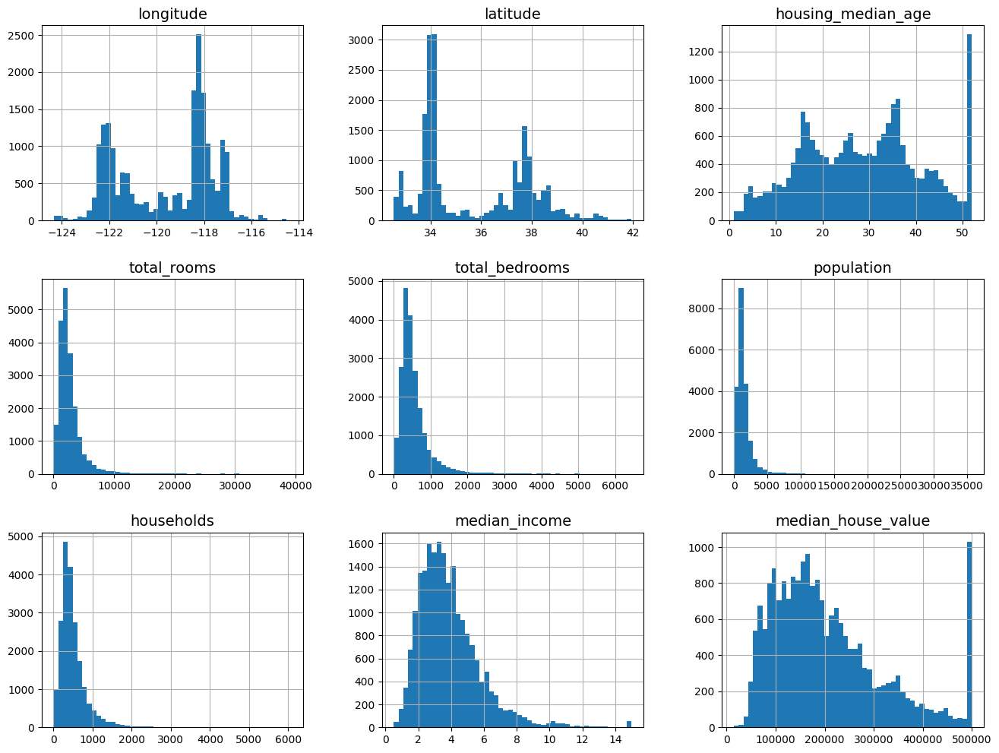

In [11]:
# Nombre del archivo para guardar la figura
filename = "attribute_histogram_plots"

# Llamamos a la función para generar y guardar los histogramas
plot_and_save_histograms(data_entrenamiento_validacion_prueba, filename)

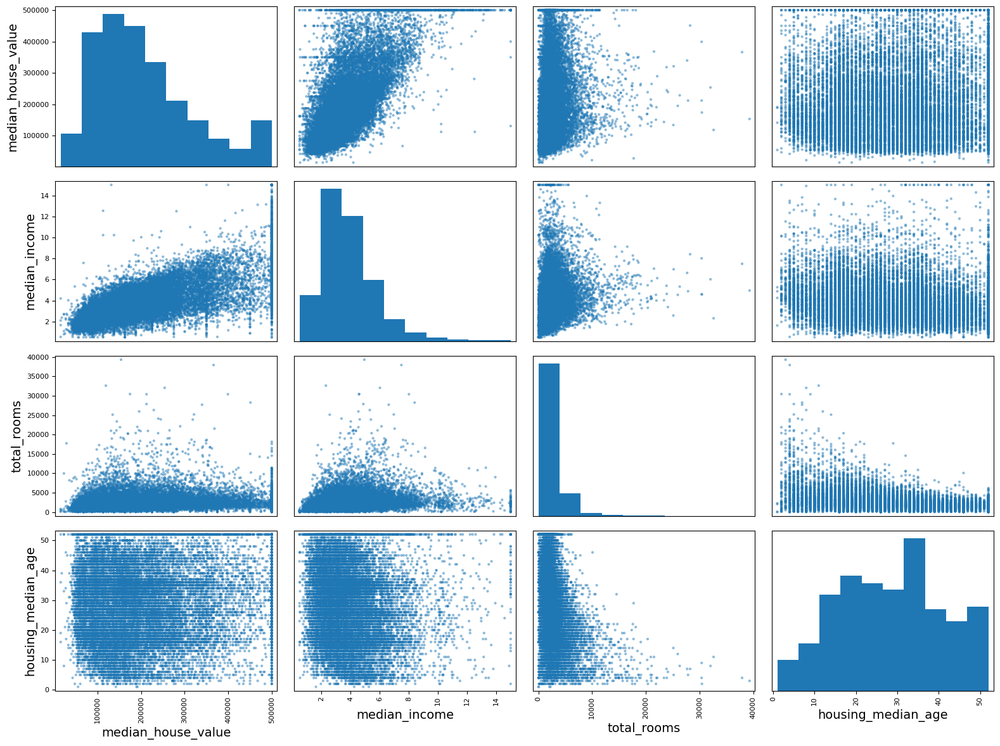

In [12]:
import matplotlib.pyplot as plt
from pandas.plotting import scatter_matrix

# Selecciona las columnas numéricas que te interesan
attributes = ["median_house_value", "median_income", "total_rooms", "housing_median_age"]

# Crea la matriz de dispersión
scatter_matrix(data_entrenamiento_validacion_prueba[attributes], figsize=(16, 12))

# Guarda la figura
save_fig("scatter_matrix_plot")

# Muestra la figura
plt.show()

# Analisis de Datos Sesgados:

Se observan datos bastante repetitivos en las columnas: 
- "housing_median_age" (muchas casas con mas de 50 años)
- "median_house_value" (muchas casas con mas de 500 mil dolares)

<span style="color: red;">Se procede a contabilizar la cantidad de datos repetidos</span>

### Top 10 de valores mas repetidos en la columna *'median_house_value'*

In [13]:
# Contar la frecuencia de cada valor en 'median_house_value'
value_counts = data_entrenamiento_validacion_prueba['median_house_value'].value_counts()

# Convertir la Serie en DataFrame
value_counts_df = value_counts.reset_index()
value_counts_df.columns = ['valor', 'cantidad']

# Calcular el porcentaje que representa cada valor
total_count = value_counts_df['cantidad'].sum()
value_counts_df['porcentaje'] = round((value_counts_df['cantidad'] / total_count) * 100, 2)

# Obtener el top 10 de los valores más frecuentes
top_10_values = value_counts_df.head(10)

# Configurar el índice
top_10_values.index.name

# Mostrar la tabla resultante
top_10_values


,valor,cantidad,porcentaje
0,500001.0,965,4.68
1,137500.0,122,0.59
2,162500.0,117,0.57
3,112500.0,103,0.50
4,187500.0,93,0.45
5,225000.0,92,0.45
6,350000.0,79,0.38
7,87500.0,78,0.38
8,275000.0,65,0.31
9,150000.0,64,0.31


### Top 10 de valores mas repetidos en la columna *'housing_median_age'*

In [14]:
# Contar la frecuencia de cada valor en 'housing_median_age'
age_value_counts = data_entrenamiento_validacion_prueba['housing_median_age'].value_counts()

# Convertir la Serie en DataFrame
age_value_counts_df = age_value_counts.reset_index()
age_value_counts_df.columns = ['edad_media', 'cantidad']

# Calcular el porcentaje que representa cada valor
total_age_count = age_value_counts_df['cantidad'].sum()
age_value_counts_df['porcentaje'] = round((age_value_counts_df['cantidad'] / total_age_count) * 100, 2)

# Obtener el top 10 de los valores más frecuentes
top_10_ages = age_value_counts_df.head(10)

# Configurar el índice
top_10_ages.index.name

# Mostrar la tabla resultante
top_10_ages

,edad_media,cantidad,porcentaje
0,52.0,1273,6.17
1,36.0,862,4.18
2,35.0,824,3.99
3,16.0,771,3.74
4,17.0,698,3.38
5,34.0,689,3.34
6,26.0,619,3.00
7,33.0,615,2.98
8,18.0,570,2.76
9,25.0,566,2.74


## Para resolver estas anomalias se intentan estas dos estrategias:

- Aplicar la transformación logarítmica <span style="color: red;">(No funciono)</span>
- Eliminar filas de las columnas 'median_house_value' y 'housing_median_age' <span style="color: green;">(Me gusta el resultado)</span>

In [15]:
# # Aplicar la transformación logarítmica a 'median_house_value' solo para valores >= 500000
# data_entrenamiento_validacion_prueba['median_house_value'] = data_entrenamiento_validacion_prueba['median_house_value'].apply(
#     lambda x: np.log1p(x) if x >= 500000 else x
# )

# # Aplicar la transformación logarítmica a 'housing_median_age' solo para valores >= 50
# data_entrenamiento_validacion_prueba['housing_median_age'] = data_entrenamiento_validacion_prueba['housing_median_age'].apply(
#     lambda x: np.log1p(x) if x >= 50 else x
# )

In [16]:
# # Nombre del archivo para guardar la figura
# filename = "attribute_histogram_plots_logaritmica"

# # Llamamos a la función para generar y guardar los histogramas
# plot_and_save_histograms(data_entrenamiento_validacion_prueba, filename)

In [17]:
# Eliminar filas donde el precio medio de las casas es >= 500000
data_entrenamiento_validacion_prueba = data_entrenamiento_validacion_prueba[
    data_entrenamiento_validacion_prueba['median_house_value'] <= 500000
]

# Eliminar filas donde la edad mediana de las casas es >= 50
data_entrenamiento_validacion_prueba = data_entrenamiento_validacion_prueba[
    data_entrenamiento_validacion_prueba['housing_median_age'] <= 50
]

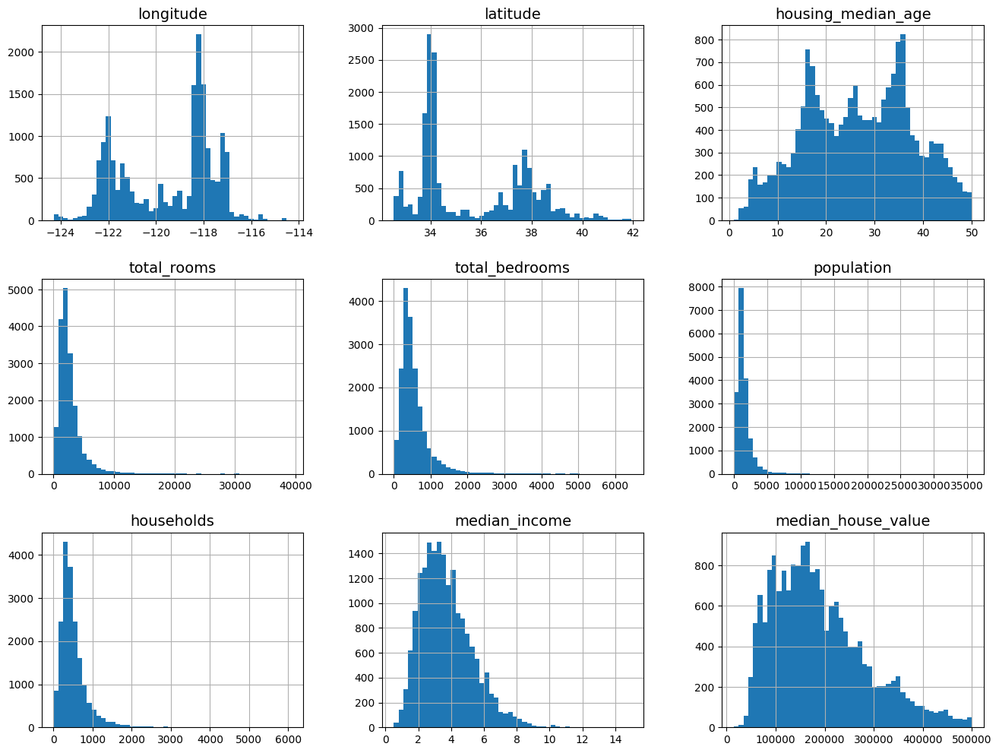

In [18]:
# Nombre del archivo para guardar la figura
filename = "attribute_histogram_plots_eliminacion"

# Llamamos a la función para generar y guardar los histogramas
plot_and_save_histograms(data_entrenamiento_validacion_prueba, filename)

----------------------------------------

# Generar Graficas de Correlacion

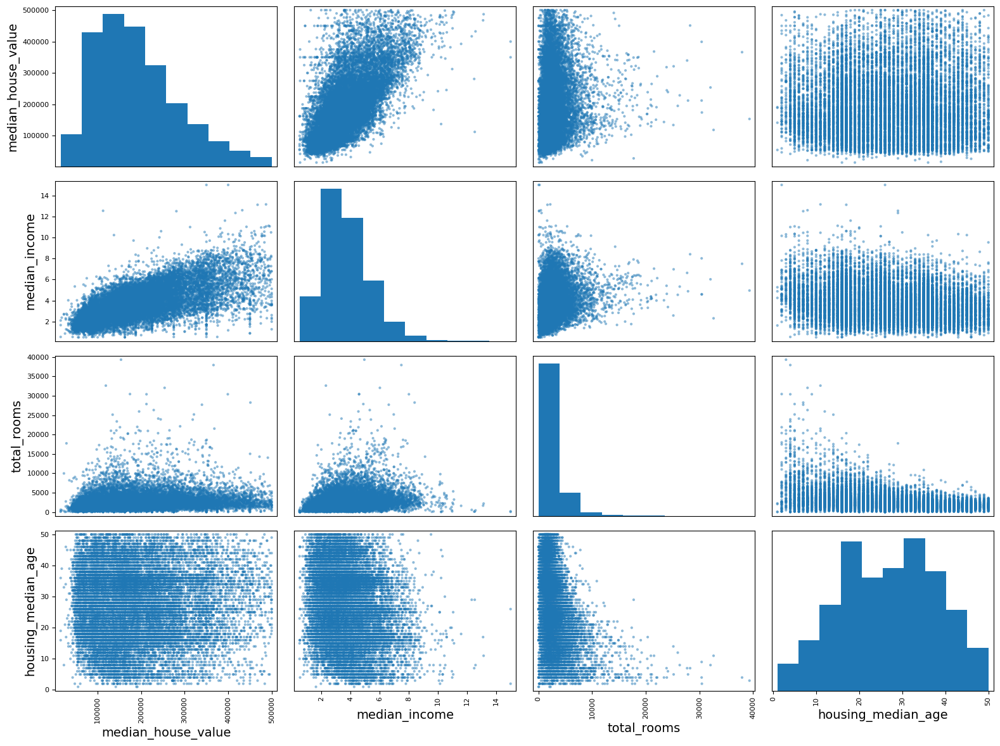

In [19]:
import matplotlib.pyplot as plt
from pandas.plotting import scatter_matrix

# Selecciona las columnas numéricas que te interesan
attributes = ["median_house_value", "median_income", "total_rooms", "housing_median_age"]

# Crea la matriz de dispersión
scatter_matrix(data_entrenamiento_validacion_prueba[attributes], figsize=(16, 12))

# Guarda la figura
save_fig("scatter_matrix_plot_limpia")

# Muestra la figura
plt.show()

## Existe una Fuerte Correlacion entre:

<span style="color: green;">x="median_income", y="median_house_value"</span>

<Figure size 1600x1200 with 0 Axes>

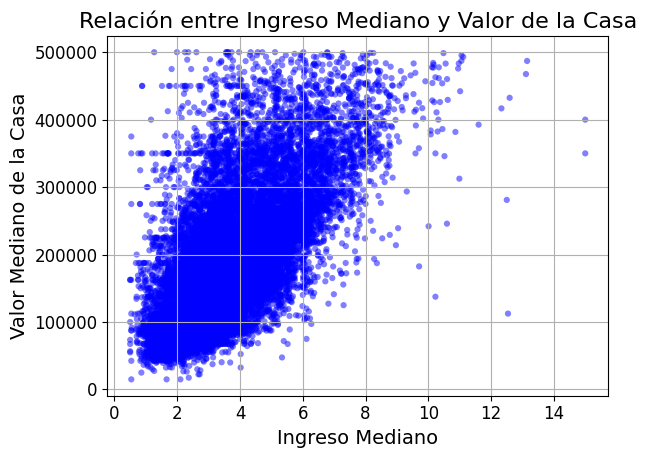

In [20]:
def plot_income_vs_house_value(data, fig_id="income_vs_house_value_scatterplot"):
    """
    Genera un gráfico de dispersión que muestra la relación entre 'median_income' y 'median_house_value'.
    
    Args:
        data (pd.DataFrame): El DataFrame que contiene los datos.
        fig_id (str): El identificador de la figura para guardar el archivo. Por defecto es 'income_vs_house_value_scatterplot'.
    """
    # Crear el gráfico de dispersión
    plt.figure(figsize=(16, 12))
    scatter = data.plot(kind="scatter", x="median_income", y="median_house_value",
                        alpha=0.5, grid=True, color='blue', edgecolor='none')
    
    # Personalizar el gráfico
    plt.title("Relación entre Ingreso Mediano y Valor de la Casa", fontsize=16)
    plt.xlabel("Ingreso Mediano", fontsize=14)
    plt.ylabel("Valor Mediano de la Casa", fontsize=14)
    plt.tick_params(axis='both', which='major', labelsize=12)
    
    # Guardar la figura y mostrarla
    save_fig(fig_id) 
    plt.show()

# Llamar a la función con el DataFrame
plot_income_vs_house_value(data_entrenamiento_validacion_prueba)

----------------------------------------

# Experimentar con Combinaciones de Atributos

En el análisis de datos y la preparación de datos para el modelado de machine learning, una práctica común es crear nuevas características a partir de las existentes. Esta técnica se conoce como ingeniería de características y puede proporcionar información adicional que ayude a mejorar el rendimiento del modelo. En este caso, vamos a crear tres nuevas características basadas en las columnas de nuestro conjunto de datos de viviendas.

1. **rooms_per_house (habitaciones por hogar)**:
   Esta nueva característica se obtiene dividiendo el número total de habitaciones por el número de hogares en cada distrito. La fórmula es:
   \[
   \text{rooms\_per\_house} = \frac{\text{total\_rooms}}{\text{households}}
   \]
   Esta característica nos indica el promedio de habitaciones por hogar, lo que puede ayudar a comprender la densidad de las viviendas en un área.

2. **bedrooms_ratio (proporción de dormitorios)**:
   Esta característica se obtiene dividiendo el número total de dormitorios por el número total de habitaciones en cada distrito. La fórmula es:
   \[
   \text{bedrooms\_ratio} = \frac{\text{total\_bedrooms}}{\text{total\_rooms}}
   \]
   La proporción de dormitorios puede proporcionar información sobre la distribución de las habitaciones en una casa. Por ejemplo, una alta proporción de dormitorios puede indicar una vivienda más pequeña y económica, mientras que una baja proporción puede indicar una vivienda más espaciosa.

3. **people_per_house (personas por hogar)**:
   Esta característica se obtiene dividiendo la población total por el número de hogares en cada distrito. La fórmula es:
   \[
   \text{people\_per\_house} = \frac{\text{population}}{\text{households}}
   \]
   Esta característica nos indica el promedio de personas por hogar, lo que puede ayudar a comprender la densidad de población en un área y su posible impacto en el valor de las propiedades.

Aquí está el código que realiza estas transformaciones en el conjunto de datos `data_entrenamiento_validacion_prueba`:

In [21]:
# Creación de nuevas características a partir de las existentes

# Calculamos el número promedio de habitaciones por hogar
data_entrenamiento_validacion_prueba["rooms_per_house"] = data_entrenamiento_validacion_prueba["total_rooms"] / data_entrenamiento_validacion_prueba["households"]

# Calculamos la proporción de dormitorios en comparación con el número total de habitaciones
data_entrenamiento_validacion_prueba["bedrooms_ratio"] = data_entrenamiento_validacion_prueba["total_bedrooms"] / data_entrenamiento_validacion_prueba["total_rooms"]

# Calculamos el número promedio de personas por hogar
data_entrenamiento_validacion_prueba["people_per_house"] = data_entrenamiento_validacion_prueba["population"] / data_entrenamiento_validacion_prueba["households"]

Al realizar estas transformaciones, estamos enriqueciendo nuestro conjunto de datos con nuevas características que pueden proporcionar información adicional útil para nuestros modelos de machine learning. Esto puede ayudar a mejorar la precisión y la capacidad predictiva de nuestros modelos, permitiéndonos capturar relaciones más complejas en los datos.

In [22]:
data_entrenamiento_validacion_prueba

,id,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity,rooms_per_house,bedrooms_ratio,people_per_house
0,d26c30c880494037a1fda26957f6247a,-122.23,37.88,41.0,880.0,129.0,322.0,126.0,8.3252,452600.0,NEAR BAY,6.984127,0.146591,2.555556
1,3556a77bb1ff85f2b75906f1001a0f1a,-122.22,37.86,21.0,7099.0,1106.0,2401.0,1138.0,8.3014,358500.0,NEAR BAY,6.238137,0.155797,2.109842
8,8ab9532ab3d168d0f781a826dd79dbc4,-122.26,37.84,42.0,2555.0,665.0,1206.0,595.0,2.0804,226700.0,NEAR BAY,4.294118,0.260274,2.026891
15,d0eba8bef70c08239dc6190e3996059f,-122.26,37.85,50.0,1120.0,283.0,697.0,264.0,2.1250,140000.0,NEAR BAY,4.242424,0.252679,2.640152
18,5b9c7fac3b0c610b03de2fc8458f4838,-122.26,37.84,50.0,2239.0,455.0,990.0,419.0,1.9911,158700.0,NEAR BAY,5.343675,0.203216,2.362768
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20635,ff2b1babc26cfbbb934a23295bb4e4b7,-121.09,39.48,25.0,1665.0,374.0,845.0,330.0,1.5603,78100.0,INLAND,5.045455,0.224625,2.560606
20636,47d76d34caad4d1958966543621a6358,-121.21,39.49,18.0,697.0,150.0,356.0,114.0,2.5568,77100.0,INLAND,6.114035,0.215208,3.122807
20637,1640ee153b9b7f01f9e0ddcc5d62fdf2,-121.22,39.43,17.0,2254.0,485.0,1007.0,433.0,1.7000,92300.0,INLAND,5.205543,0.215173,2.325635
20638,47c80c401d58e0602629a70852a5d248,-121.32,39.43,18.0,1860.0,409.0,741.0,349.0,1.8672,84700.0,INLAND,5.329513,0.219892,2.123209


# Matriz de Correlacion

In [23]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

# Filtrar las columnas específicas para la matriz de correlación
columns_of_interest = [
    "median_house_value", "median_income", "rooms_per_house",
    "total_rooms", "housing_median_age", "households",
    "total_bedrooms", "population", "people_per_house",
    "longitude", "latitude", "bedrooms_ratio"
]

# Crear un nuevo DataFrame con las columnas de interés
subset_data = data_entrenamiento_validacion_prueba[columns_of_interest]

# Calcular la matriz de correlación
correlation_matrix = subset_data.corr()

# Configuración de la visualización
plt.figure(figsize=(12, 8))

# Crear un mapa de calor de la matriz de correlación
sns.heatmap(correlation_matrix, annot=True, fmt=".2f", cmap="coolwarm", vmin=-1, vmax=1, cbar=True)

# Título y visualización
plt.title("Matriz de Correlación")
save_fig("correlation_matrix_heatmap")  # Guardar la figura
plt.show()

# Visualizar las correlaciones específicas con 'median_house_value'
correlation_with_median_house_value = correlation_matrix["median_house_value"].sort_values(ascending=False)
print("Correlaciones con 'median_house_value':\n", correlation_with_median_house_value)

KeyboardInterrupt: 

### Diagnóstico de Correlaciones con `median_house_value`

1. **Alta Correlación Positiva**:
   - **`median_income` (0.661)**: Esta es la variable más correlacionada con el valor de la vivienda. Indica que a mayor ingreso medio, mayor es el valor de la vivienda, lo cual es un hallazgo significativo para el modelo.

2. **Correlación Positiva Moderada a Baja**:
   - **`total_rooms` (0.153)**: Hay una correlación positiva leve, lo que sugiere que más habitaciones totales en la vivienda podrían asociarse ligeramente con un mayor valor.
   - **`rooms_per_house` (0.114)** y **`households` (0.100)**: Ambas muestran una correlación positiva débil con el valor de la vivienda.

3. **Correlación Positiva Muy Débil**:
   - **`total_bedrooms` (0.080)** y **`population` (0.022)**: Correlaciones muy débiles, lo que sugiere que no influyen significativamente en el valor de la vivienda.
   - **`housing_median_age` (0.014)**: Prácticamente no hay relación entre la antigüedad de las viviendas y su valor.

4. **Correlación Negativa Débil**:
   - **`longitude` (-0.022)** y **`people_per_house` (-0.020)**: Estas variables muestran una correlación negativa muy débil, indicando que no tienen un impacto significativo en el valor de la vivienda.

5. **Correlación Negativa Moderada**:
   - **`latitude` (-0.172)**: Una correlación negativa leve, sugiriendo que la ubicación norte-sur podría tener algún impacto en el valor de la vivienda, aunque no muy fuerte.
   - **`bedrooms_ratio` (-0.230)**: Una correlación negativa moderada, sugiriendo que una mayor proporción de dormitorios respecto a las habitaciones totales podría estar asociada con un menor valor de la vivienda.

### Conclusión

La variable más relevante para predecir el valor de la vivienda es el ingreso medio (`median_income`). Las demás variables tienen correlaciones muy débiles y no son tan significativas. Es importante considerar esto al seleccionar características para tu modelo de machine learning, enfocándote en aquellas con mayor correlación para mejorar la precisión del modelo.

----------------------------------------

# Visualizacion Geografica de los Datos

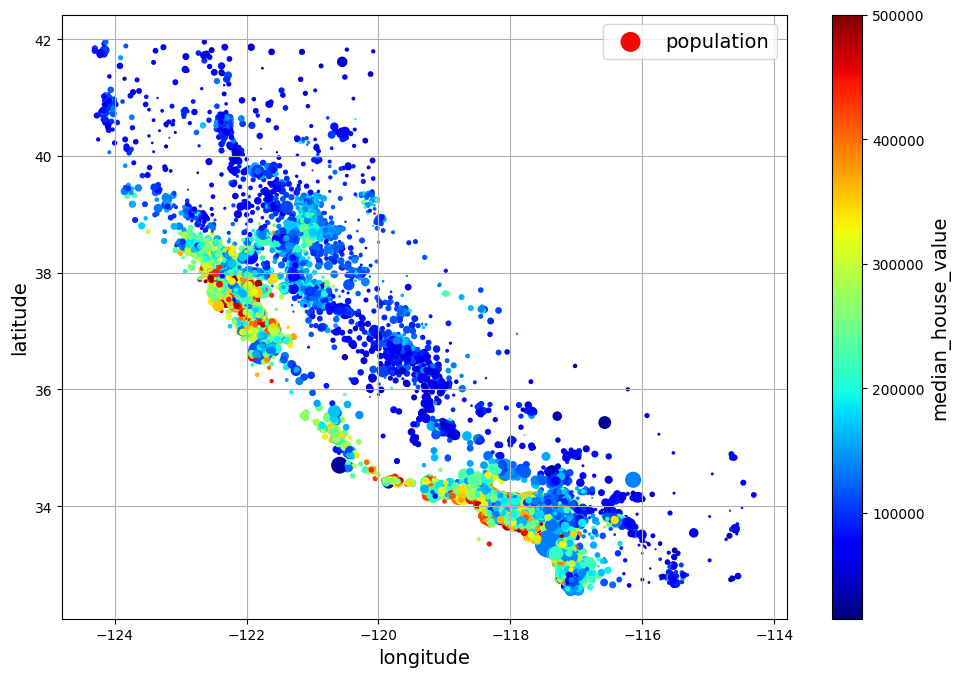

In [ ]:
# Genera un gráfico de dispersión para visualizar la relación entre la longitud y la latitud de las viviendas.
# El tamaño de los puntos en el gráfico está relacionado con la población de la zona.
# El color de los puntos representa el valor mediano de las casas, usando un mapa de colores 'jet'.

data_entrenamiento_validacion_prueba.plot(kind="scatter", x="longitude", y="latitude", grid=True,
             s=data_entrenamiento_validacion_prueba["population"] / 100,  # Tamaño de los puntos, proporcional a la población (dividido por 100 para ajustar el tamaño)
             label="population",  # Etiqueta para la leyenda, indicando que el tamaño de los puntos representa la población
             c="median_house_value",  # Color de los puntos basado en el valor mediano de las casas
             cmap="jet",  # Mapa de colores utilizado para representar los valores de 'median_house_value'
             colorbar=True,  # Muestra una barra de colores al lado del gráfico para indicar el rango de valores de 'median_house_value'
             legend=True,  # Muestra la leyenda en el gráfico
             sharex=False,  # No comparte el eje x con otros gráficos si se hacen múltiples gráficos en una misma figura
             figsize=(10, 7))  # Tamaño de la figura del gráfico

# Guarda la figura generada utilizando la función save_fig, con el nombre especificado
save_fig("housing_prices_scatterplot")

# Muestra el gráfico en pantalla
plt.show()

In [ ]:
import folium
import pandas as pd
from folium import LinearColormap
from pathlib import Path

# Suponiendo que tienes el DataFrame en 'data_entrenamiento_validacion_prueba'
# data_entrenamiento_validacion_prueba = pd.read_csv("path_to_your_dataset.csv")

# Inicializamos la ruta para guardar el archivo HTML
IMAGES_PATH = Path("images") / "end_to_end_project"
IMAGES_PATH.mkdir(parents=True, exist_ok=True)  # Crear el directorio si no existe

# Inicializamos el mapa centrado en el punto medio de las coordenadas de los datos
map_center = [data_entrenamiento_validacion_prueba["latitude"].mean(), 
              data_entrenamiento_validacion_prueba["longitude"].mean()]

# Crear un objeto de mapa de folium
mymap = folium.Map(location=map_center, zoom_start=10, width=1200, height=800)

# Normalizar los precios para la escala de colores
price_min = data_entrenamiento_validacion_prueba["median_house_value"].min()
price_max = data_entrenamiento_validacion_prueba["median_house_value"].max()

# Asegúrate de que el rango de normalización esté en [0, 1]
price_normalized = (data_entrenamiento_validacion_prueba["median_house_value"] - price_min) / (price_max - price_min)

# Crear un colormap de colores basado en la normalización de precios
colormap = LinearColormap(['blue', 'cyan', 'green', 'yellow', 'orange', 'red'], vmin=0, vmax=1)

# Crear una función de color basado en la normalización del precio
def price_color(price_norm):
    # Asegúrate de que price_norm esté dentro del rango [0, 1]
    price_norm = min(max(price_norm, 0), 1)
    return colormap(price_norm)

# Añadir puntos al mapa
for idx, row in data_entrenamiento_validacion_prueba.iterrows():
    folium.CircleMarker(
        location=[row['latitude'], row['longitude']],
        radius=row['population'] / 1000,  # Ajusta el tamaño de los puntos según la población
        color=price_color(price_normalized[idx]),
        fill=True,
        fill_color=price_color(price_normalized[idx]),
        fill_opacity=0.6,
        popup=f"Price: ${row['median_house_value']:,.0f}"  # Muestra el precio al hacer clic en el punto
    ).add_to(mymap)

# Añadir una barra de colores para representar los precios
colormap.add_to(mymap)

# Guarda el mapa en un archivo HTML en la ruta especificada
mymap.save(IMAGES_PATH / "housing_map.html")

# Muestra el mapa en el entorno Jupyter (opcional)
mymap


----------------------------------------

# Limpieza de los datos

In [ ]:
data_entrenamiento_validacion_prueba.info()

<class 'pandas.core.frame.DataFrame'>
Index: 18528 entries, 0 to 20639
Data columns (total 14 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   id                  18528 non-null  object 
 1   longitude           18528 non-null  float64
 2   latitude            18528 non-null  float64
 3   housing_median_age  18528 non-null  float64
 4   total_rooms         18528 non-null  float64
 5   total_bedrooms      18336 non-null  float64
 6   population          18528 non-null  float64
 7   households          18528 non-null  float64
 8   median_income       18528 non-null  float64
 9   median_house_value  18528 non-null  float64
 10  ocean_proximity     18528 non-null  object 
 11  rooms_per_house     18528 non-null  float64
 12  bedrooms_ratio      18336 non-null  float64
 13  people_per_house    18528 non-null  float64
dtypes: float64(12), object(2)
memory usage: 2.6+ MB


*Tengo valores vacios en las columnas:*

- **'total_bedrooms'**
- **'bedrooms_ratio'**

## Código para Manejo de Valores Faltantes
A continuación, metodo para manejar los valores faltantes en el DataFrame:

*Aplico dos Metodos*
- Uso de libreria Scikit-Learn <span style="color: green;">(Selecciono este metodo)</span>
- Uso el método fillna() de pandas

In [ ]:
import pandas as pd
from sklearn.impute import SimpleImputer

# Parte 1: Imprimir las medianas de cada columna numérica
# Seleccionar solo las columnas numéricas
numerical_columns = data_entrenamiento_validacion_prueba.select_dtypes(include=[np.number])

# Calcular la mediana de cada columna numérica
medians = numerical_columns.median()

# Imprimir los nombres de las columnas y sus medianas
print("Medianas de las columnas numéricas:")
medians


Medianas de las columnas numéricas:


longitude               -118.450000
latitude                  34.240000
housing_median_age        27.000000
total_rooms             2143.000000
total_bedrooms           442.000000
population              1204.500000
households               416.000000
median_income              3.470150
median_house_value    171200.000000
rooms_per_house            5.210593
bedrooms_ratio             0.203810
people_per_house           2.856337
dtype: float64

In [ ]:
# Parte 2: Imputar los valores faltantes con la mediana de cada columna

# Crear un imputador que reemplace los valores faltantes por la mediana de cada columna
imputer = SimpleImputer(strategy="median")

# Seleccionar todas las columnas numéricas
# select_dtypes(include=[np.number]) selecciona todas las columnas numéricas del DataFrame
# .columns devuelve los nombres de estas columnas
numeric_columns = data_entrenamiento_validacion_prueba.select_dtypes(include=[np.number]).columns

# Aplicar el imputador a las columnas numéricas
# fit_transform ajusta el imputador a los datos y luego transforma los datos,
# reemplazando los valores faltantes con la mediana de cada columna
data_entrenamiento_validacion_prueba[numeric_columns] = imputer.fit_transform(data_entrenamiento_validacion_prueba[numeric_columns])

# Verificar que no queden valores faltantes
# data_entrenamiento_validacion_prueba.info() imprime un resumen del DataFrame,
# mostrando el conteo de valores no nulos en cada columna para confirmar que no hay valores faltantes
print(data_entrenamiento_validacion_prueba.info())


<class 'pandas.core.frame.DataFrame'>
Index: 18528 entries, 0 to 20639
Data columns (total 14 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   id                  18528 non-null  object 
 1   longitude           18528 non-null  float64
 2   latitude            18528 non-null  float64
 3   housing_median_age  18528 non-null  float64
 4   total_rooms         18528 non-null  float64
 5   total_bedrooms      18528 non-null  float64
 6   population          18528 non-null  float64
 7   households          18528 non-null  float64
 8   median_income       18528 non-null  float64
 9   median_house_value  18528 non-null  float64
 10  ocean_proximity     18528 non-null  object 
 11  rooms_per_house     18528 non-null  float64
 12  bedrooms_ratio      18528 non-null  float64
 13  people_per_house    18528 non-null  float64
dtypes: float64(12), object(2)
memory usage: 2.6+ MB
None


In [ ]:
# # Imputar valores faltantes en 'total_bedrooms' y 'bedrooms_ratio' con la mediana
# # Este paso sustituye los valores faltantes en las columnas 'total_bedrooms' y 'bedrooms_ratio' 
# # con la mediana de cada una de estas columnas.
# # Utilizamos el método fillna() de pandas, pasando la mediana de la columna correspondiente 
# # y especificando inplace=True para modificar el DataFrame original.

# # Para la columna 'total_bedrooms', se sustituye cualquier valor faltante con la mediana de 'total_bedrooms'
# data_entrenamiento_validacion_prueba['total_bedrooms'].fillna(data_entrenamiento_validacion_prueba['total_bedrooms'].median(), inplace=True)

# # Para la columna 'bedrooms_ratio', se sustituye cualquier valor faltante con la mediana de 'bedrooms_ratio'
# data_entrenamiento_validacion_prueba['bedrooms_ratio'].fillna(data_entrenamiento_validacion_prueba['bedrooms_ratio'].median(), inplace=True)

# # Verificar que no queden valores faltantes
# # Imprimimos información del DataFrame para asegurarnos de que ya no hay valores faltantes en las columnas
# # Verificamos las columnas para asegurarnos de que no tienen valores nulos después de la imputación
# print(data_entrenamiento_validacion_prueba.info())


In [ ]:
data_entrenamiento_validacion_prueba

,id,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity,rooms_per_house,bedrooms_ratio,people_per_house
0,d26c30c880494037a1fda26957f6247a,-122.23,37.88,41.0,880.0,129.0,322.0,126.0,8.3252,452600.0,NEAR BAY,6.984127,0.146591,2.555556
1,3556a77bb1ff85f2b75906f1001a0f1a,-122.22,37.86,21.0,7099.0,1106.0,2401.0,1138.0,8.3014,358500.0,NEAR BAY,6.238137,0.155797,2.109842
8,8ab9532ab3d168d0f781a826dd79dbc4,-122.26,37.84,42.0,2555.0,665.0,1206.0,595.0,2.0804,226700.0,NEAR BAY,4.294118,0.260274,2.026891
15,d0eba8bef70c08239dc6190e3996059f,-122.26,37.85,50.0,1120.0,283.0,697.0,264.0,2.1250,140000.0,NEAR BAY,4.242424,0.252679,2.640152
18,5b9c7fac3b0c610b03de2fc8458f4838,-122.26,37.84,50.0,2239.0,455.0,990.0,419.0,1.9911,158700.0,NEAR BAY,5.343675,0.203216,2.362768
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20635,ff2b1babc26cfbbb934a23295bb4e4b7,-121.09,39.48,25.0,1665.0,374.0,845.0,330.0,1.5603,78100.0,INLAND,5.045455,0.224625,2.560606
20636,47d76d34caad4d1958966543621a6358,-121.21,39.49,18.0,697.0,150.0,356.0,114.0,2.5568,77100.0,INLAND,6.114035,0.215208,3.122807
20637,1640ee153b9b7f01f9e0ddcc5d62fdf2,-121.22,39.43,17.0,2254.0,485.0,1007.0,433.0,1.7000,92300.0,INLAND,5.205543,0.215173,2.325635
20638,47c80c401d58e0602629a70852a5d248,-121.32,39.43,18.0,1860.0,409.0,741.0,349.0,1.8672,84700.0,INLAND,5.329513,0.219892,2.123209


----------------------------------------

# Manejar Atributos de Texto y Categorico

En la tabla tengo una columna que contiene valores de texto: **ocean_proximity**

<span style="color: green;">El siguiente paso es preparar esta columna para el modelo de aprendizaje</span>

In [ ]:
# Seleccionar Columna

# Seleccionar la columna 'ocean_proximity'
aproximacion_oceano = data_entrenamiento_validacion_prueba[['ocean_proximity']]

# Mostrar los primeros 5 valores de la columna
aproximacion_oceano.head()

,ocean_proximity
0,NEAR BAY
1,NEAR BAY
8,NEAR BAY
15,NEAR BAY
18,NEAR BAY


In [ ]:
# Ver y contabilizar la cantidad de valores unicos que hay en la columna

# Contabilizar la cantidad de valores únicos en la columna 'ocean_proximity'
valores_unicos = aproximacion_oceano['ocean_proximity'].value_counts()

# Mostrar los valores únicos y su conteo
valores_unicos

ocean_proximity
<1H OCEAN     8319
INLAND        6331
NEAR OCEAN    2322
NEAR BAY      1554
ISLAND           2
Name: count, dtype: int64

# Codificación de la Columna 'ocean_proximity'

### ¿Por qué se realiza la codificación de la columna 'ocean_proximity'?

En el análisis de datos y la creación de modelos de machine learning, es fundamental convertir las variables categóricas a un formato numérico que pueda ser procesado por los algoritmos. La columna `ocean_proximity` contiene categorías de texto que indican la proximidad de las casas al océano. Estas categorías son:

- `<1H OCEAN`
- `INLAND`
- `NEAR OCEAN`
- `NEAR BAY`
- `ISLAND`

### Problemas con las Categorías de Texto

1. **No Orden:** Las categorías de `ocean_proximity` no tienen un orden intrínseco. No se puede decir que `<1H OCEAN` es mayor o menor que `INLAND` de una manera que tenga sentido para los algoritmos de machine learning.
2. **Dificultad de Interpretación:** Los modelos de machine learning no pueden interpretar categorías de texto directamente, ya que esperan entradas numéricas.

### Solución: Codificación de Variables Categóricas

Existen dos enfoques principales para convertir estas categorías de texto en valores numéricos: `OrdinalEncoder` y `OneHotEncoder`.

#### OrdinalEncoder
El `OrdinalEncoder` asigna un número entero único a cada categoría. Sin embargo, este enfoque puede introducir un orden artificial entre las categorías, lo cual no es adecuado en este caso porque las categorías de `ocean_proximity` no tienen un orden lógico.

<span style="color: green;">El problema con este método es que la columna tiene 5 valores que describen la cercanía al océano y, al momento de codificar la columna, tendré valores del 0 al 4. Esto está bien, sin embargo, el modelo podría suponer que 0 es mejor que 4 y/o 1 es mejor que 3 o viceversa. Es por esta razón que no se usa en este caso este tipo de codificación.<br> Un caso de uso sería si la columna solo tuviera dos valores (bueno, malo).</span>

#### OneHotEncoder
El `OneHotEncoder` crea una nueva columna binaria (0 o 1) para cada categoría. Este enfoque es más adecuado para variables categóricas no ordinales porque no introduce un orden artificial. 

### Ventajas de Usar OneHotEncoder

1. **Eliminación de Orden Artificial:** Cada categoría se representa de manera independiente, evitando la introducción de un orden que no tiene sentido.
2. **Mejor Interpretabilidad:** Los modelos pueden interpretar cada categoría como una entidad independiente.
3. **Compatibilidad con Algoritmos de Machine Learning:** Muchos algoritmos de machine learning funcionan mejor con variables categóricas codificadas como binarios.

### Implementación en el Proyecto

En nuestro conjunto de datos, utilizamos `OneHotEncoder` para convertir la columna `ocean_proximity` en varias columnas binarias. Este proceso asegura que los datos sean adecuados para el modelado y mejora la capacidad del modelo para aprender patrones relevantes en los datos.

### Ejemplo de Codificación

Originalmente, la columna `ocean_proximity` se ve así:

| ocean_proximity |
|-----------------|
| <1H OCEAN       |
| INLAND          |
| NEAR OCEAN      |
| NEAR BAY        |
| ISLAND          |

Después de aplicar `OneHotEncoder`, se transforma en:

| ocean_proximity_<1H OCEAN | ocean_proximity_INLAND | ocean_proximity_NEAR OCEAN | ocean_proximity_NEAR BAY | ocean_proximity_ISLAND |
|---------------------------|------------------------|----------------------------|--------------------------|------------------------|
| 1                         | 0                      | 0                          | 0                        | 0                      |
| 0                         | 1                      | 0                          | 0                        | 0                      |
| 0                         | 0                      | 1                          | 0                        | 0                      |
| 0                         | 0                      | 0                          | 1                        | 0                      |
| 0                         | 0                      | 0                          | 0                        | 1                      |

Este proceso facilita que los algoritmos de machine learning utilicen la información de `ocean_proximity` sin introducir sesgos o malinterpretaciones debido a un orden artificial.

In [ ]:
from sklearn.preprocessing import OneHotEncoder

# Seleccionar la columna de 'ocean_proximity'
# Se selecciona la columna 'ocean_proximity' del DataFrame 'data_entrenamiento_validacion_prueba' para ser codificada.
aproximacion_oceano = data_entrenamiento_validacion_prueba[['ocean_proximity']]

# Crear un objeto OneHotEncoder
# Se crea una instancia del codificador OneHotEncoder con el parámetro 'sparse_output=True' para que la salida sea una matriz dispersa (Esto es útil para ahorrar memoria al trabajar con datos que tienen muchos ceros).
encoder = OneHotEncoder(sparse_output=True)

# Aplicar el codificador a la columna
# Se ajusta el codificador a los datos y se transforma la columna 'ocean_proximity' en una matriz dispersa de One-Hot Encoding.
aproximacion_oceano_encoded = encoder.fit_transform(aproximacion_oceano)

# Convertir a DataFrame y agregar nombres de columnas
# Se convierte la matriz dispersa a un DataFrame denso y se añaden los nombres de las columnas generadas por el codificador.
aproximacion_oceano_encoded_df = pd.DataFrame(
    aproximacion_oceano_encoded.toarray(), 
    columns=encoder.get_feature_names_out(['ocean_proximity'])
)

# Concatenar las columnas codificadas con el DataFrame original
# Se concatenan las nuevas columnas codificadas al DataFrame original 'data_entrenamiento_validacion_prueba'.
data_entrenamiento_validacion_prueba = pd.concat([data_entrenamiento_validacion_prueba, aproximacion_oceano_encoded_df], axis=1)

# Ver los datos codificados
# Se imprimen las primeras filas del DataFrame para verificar que la codificación se realizó correctamente.
data_entrenamiento_validacion_prueba.head()


,id,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity,rooms_per_house,bedrooms_ratio,people_per_house,ocean_proximity_<1H OCEAN,ocean_proximity_INLAND,ocean_proximity_ISLAND,ocean_proximity_NEAR BAY,ocean_proximity_NEAR OCEAN
0,d26c30c880494037a1fda26957f6247a,-122.23,37.88,41.0,880.0,129.0,322.0,126.0,8.3252,452600.0,NEAR BAY,6.984127,0.146591,2.555556,0.0,0.0,0.0,1.0,0.0
1,3556a77bb1ff85f2b75906f1001a0f1a,-122.22,37.86,21.0,7099.0,1106.0,2401.0,1138.0,8.3014,358500.0,NEAR BAY,6.238137,0.155797,2.109842,0.0,0.0,0.0,1.0,0.0
8,8ab9532ab3d168d0f781a826dd79dbc4,-122.26,37.84,42.0,2555.0,665.0,1206.0,595.0,2.0804,226700.0,NEAR BAY,4.294118,0.260274,2.026891,0.0,0.0,0.0,1.0,0.0
15,d0eba8bef70c08239dc6190e3996059f,-122.26,37.85,50.0,1120.0,283.0,697.0,264.0,2.1250,140000.0,NEAR BAY,4.242424,0.252679,2.640152,0.0,0.0,0.0,1.0,0.0
18,5b9c7fac3b0c610b03de2fc8458f4838,-122.26,37.84,50.0,2239.0,455.0,990.0,419.0,1.9911,158700.0,NEAR BAY,5.343675,0.203216,2.362768,0.0,0.0,0.0,1.0,0.0


In [ ]:
# Eliminar la columna 'ocean_proximity'
data_entrenamiento_validacion_prueba.drop(columns=['ocean_proximity'], inplace=True)

# Verificar que la columna ha sido eliminada
data_entrenamiento_validacion_prueba.head()

,id,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,rooms_per_house,bedrooms_ratio,people_per_house,ocean_proximity_<1H OCEAN,ocean_proximity_INLAND,ocean_proximity_ISLAND,ocean_proximity_NEAR BAY,ocean_proximity_NEAR OCEAN
0,d26c30c880494037a1fda26957f6247a,-122.23,37.88,41.0,880.0,129.0,322.0,126.0,8.3252,452600.0,6.984127,0.146591,2.555556,0.0,0.0,0.0,1.0,0.0
1,3556a77bb1ff85f2b75906f1001a0f1a,-122.22,37.86,21.0,7099.0,1106.0,2401.0,1138.0,8.3014,358500.0,6.238137,0.155797,2.109842,0.0,0.0,0.0,1.0,0.0
8,8ab9532ab3d168d0f781a826dd79dbc4,-122.26,37.84,42.0,2555.0,665.0,1206.0,595.0,2.0804,226700.0,4.294118,0.260274,2.026891,0.0,0.0,0.0,1.0,0.0
15,d0eba8bef70c08239dc6190e3996059f,-122.26,37.85,50.0,1120.0,283.0,697.0,264.0,2.1250,140000.0,4.242424,0.252679,2.640152,0.0,0.0,0.0,1.0,0.0
18,5b9c7fac3b0c610b03de2fc8458f4838,-122.26,37.84,50.0,2239.0,455.0,990.0,419.0,1.9911,158700.0,5.343675,0.203216,2.362768,0.0,0.0,0.0,1.0,0.0


In [ ]:
data_entrenamiento_validacion_prueba.columns

Index(['id', 'longitude', 'latitude', 'housing_median_age', 'total_rooms',
       'total_bedrooms', 'population', 'households', 'median_income',
       'median_house_value', 'rooms_per_house', 'bedrooms_ratio',
       'people_per_house', 'ocean_proximity_<1H OCEAN',
       'ocean_proximity_INLAND', 'ocean_proximity_ISLAND',
       'ocean_proximity_NEAR BAY', 'ocean_proximity_NEAR OCEAN'],
      dtype='object')

----------------------------------------

# Crear Conjuntos de Datos: Entrenamiento, Validacion y Prueba

In [ ]:
from sklearn.model_selection import train_test_split

def split_data(data, seed=42):
    """
    Esta función divide el conjunto de datos en conjuntos de entrenamiento, validación y prueba,
    y retorna las variables X_entrenamiento, Y_entrenamiento, X_validacion, Y_validacion, X_prueba y Y_prueba.
    
    Args:
    data (pd.DataFrame): El DataFrame con los datos, incluyendo la columna 'median_house_value' como etiqueta.
    seed (int): La semilla para la reproducibilidad.

    Returns:
    pd.DataFrame, pd.DataFrame, pd.Series, pd.Series, pd.DataFrame, pd.Series: 
    Los conjuntos de entrenamiento, validación y prueba para las características y la etiqueta.
    """
    # Excluir la columna 'id' de las características y definir la etiqueta
    X = data.drop(columns=['median_income', 'id'])
    y = data['median_income']
    
    # Dividir los datos en entrenamiento y validación
    X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.2, random_state=seed)
    
    # Dividir el conjunto de entrenamiento en entrenamiento final y prueba
    X_train_final, X_test, y_train_final, y_test = train_test_split(X_train, y_train, test_size=0.2, random_state=seed)
    
    # Retornar los conjuntos de datos
    return X_train_final, y_train_final, X_val, y_val, X_test, y_test

In [ ]:
# Ejemplo de uso
X_entrenamiento, Y_entrenamiento, X_validacion, Y_validacion, X_prueba, Y_prueba = split_data(data_entrenamiento_validacion_prueba)

# Verificar los resultados
print(X_entrenamiento.shape, Y_entrenamiento.shape)
print(X_validacion.shape, Y_validacion.shape)
print(X_prueba.shape, Y_prueba.shape)

(13068, 16) (13068,)
(4084, 16) (4084,)
(3267, 16) (3267,)


---------------------------------------------

# Guardar los resultados de "split_data"

In [ ]:
import os

def save_data_splits(X_entrenamiento, Y_entrenamiento, X_validacion, Y_validacion, X_prueba, Y_prueba, directory='datos_entrena_valida_prueba'):
    """
    Esta función guarda los conjuntos de datos en archivos CSV dentro de una carpeta específica.
    
    Args:
    X_entrenamiento (pd.DataFrame): Datos de entrenamiento (características).
    Y_entrenamiento (pd.Series): Etiquetas de entrenamiento.
    X_validacion (pd.DataFrame): Datos de validación (características).
    Y_validacion (pd.Series): Etiquetas de validación.
    X_prueba (pd.DataFrame): Datos de prueba (características).
    Y_prueba (pd.Series): Etiquetas de prueba.
    directory (str): El nombre de la carpeta donde se guardarán los archivos CSV.
    """
    # Crear la carpeta si no existe
    if not os.path.exists(directory):
        os.makedirs(directory)
    
    # Guardar los datos en archivos CSV
    X_entrenamiento.to_csv(os.path.join(directory, '1_X_entrenamiento.csv'), index=False)
    Y_entrenamiento.to_csv(os.path.join(directory, '1_Y_entrenamiento.csv'), index=False)
    X_validacion.to_csv(os.path.join(directory, '2_X_validacion.csv'), index=False)
    Y_validacion.to_csv(os.path.join(directory, '2_Y_validacion.csv'), index=False)
    X_prueba.to_csv(os.path.join(directory, '3_X_prueba.csv'), index=False)
    Y_prueba.to_csv(os.path.join(directory, '3_Y_prueba.csv'), index=False)

In [ ]:
# Ejemplo de uso
save_data_splits(X_entrenamiento, Y_entrenamiento, X_validacion, Y_validacion, X_prueba, Y_prueba)

----------------------------------------

# Escalado de Caracteristicas y Transformacion

# Advertencia

### Explicación de la Advertencia (Pagina 99)

**Advertencia:**
<span style="color: red;">Como con todos los estimadores, es importante ajustar los escaladores solo a los datos de entrenamiento: nunca utilices "fit()" o "fit_transform()" para nada que no sea el conjunto de entrenamiento. Una vez que tengas un escalador entrenado, puedes utilizarlo para aplicar "transform()" a cualquier otro conjunto, incluido el conjunto de validación, el de prueba y datos nuevos. Observa que, aunque los valores del conjunto de entrenamiento se escalarán al rango especificado, los datos nuevos que contienen valores atípicos pueden acabar escalados fuera del rango. Si quieres evitar esto, solo tienes que establecer el hiperparámetro "clip" como "true" (si el escalador lo permite).</span>

### Procedimiento Paso a Paso

**1. Ajustar el Escalador con Datos de Entrenamiento:**
- Selecciona el conjunto de datos de entrenamiento (`X_entrenamiento`).
- Ajusta el escalador solo con estos datos utilizando el método `fit()`.
- Esto permite al escalador aprender la distribución y las características de los datos de entrenamiento.

**2. Transformar Otros Conjuntos de Datos:**
- Una vez que el escalador ha sido ajustado con los datos de entrenamiento, utiliza el método `transform()` para escalar los datos de validación (`X_validacion`), prueba (`X_prueba`) y cualquier nuevo conjunto de datos.
- Este paso garantiza que los datos adicionales sean escalados de la misma manera que el conjunto de entrenamiento, manteniendo la consistencia.

**3. Manejar Valores Atípicos en Datos Nuevos:**
- Reconoce que los datos nuevos pueden contener valores atípicos que podrían ser escalados fuera del rango especificado durante el entrenamiento.
- Para evitar que estos valores atípicos se escalen fuera del rango, establece el hiperparámetro `clip=True` si el escalador lo permite.
- Esto asegura que los valores escalados permanezcan dentro del rango aprendido durante el entrenamiento, incluso para datos nuevos.

### Resumen del Procedimiento

1. **Ajustar el escalador**:
   - Utiliza `fit()` solo con los datos de entrenamiento (`X_entrenamiento`).

2. **Transformar otros conjuntos de datos**:
   - Aplica `transform()` a los conjuntos de validación (`X_validacion`), prueba (`X_prueba`) y nuevos datos para mantener la consistencia.

3. **Manejar valores atípicos**:
   - Utiliza el hiperparámetro `clip=True` para asegurar que los valores atípicos en los datos nuevos se mantengan dentro del rango especificado durante el entrenamiento.

### Implementación del Procedimiento en tu Código (sin el código específico)

1. **Dividir los datos**:
   - Divide los datos en conjuntos de entrenamiento, validación y prueba como ya lo haces.

2. **Ajustar el escalador**:
   - Ajusta el escalador solo con `X_entrenamiento`.

3. **Transformar los conjuntos de datos**:
   - Utiliza el escalador ajustado para transformar `X_entrenamiento`, `X_validacion` y `X_prueba`.

4. **Guardar los datos escalados**:
   - Guarda los datos escalados en archivos CSV como ya lo haces.

Este procedimiento asegura que el escalado de características se haga de manera correcta y que los conjuntos de datos de validación y prueba no influyan en el ajuste del escalador, manteniendo la integridad del proceso de entrenamiento y validación.

**1. Ajustar el Escalador con Datos de Entrenamiento:**

In [ ]:
# import pandas as pd  # Importa la biblioteca pandas para manipulación de datos
# from sklearn.preprocessing import StandardScaler  # Importa StandardScaler de scikit-learn para escalar características
# import joblib  # Importa joblib para guardar el escalador ajustado
# import numpy as np  # Asegúrate de importar numpy

# # Cargar los datos desde el archivo CSV
# X_entrenamiento = pd.read_csv("datos_entrena_valida_prueba/1_X_entrenamiento.csv")

# # Aplicar la transformación logarítmica a los datos de entrenamiento
# # Nota: np.log1p es una función segura que maneja valores cero de forma adecuada
# X_entrenamiento_log = np.log1p(X_entrenamiento)

# # Crear un objeto StandardScaler
# # StandardScaler estandariza las características eliminando la media y escalando a la varianza unitaria
# # 'copy=True' indica que se debe realizar una copia de los datos durante el ajuste y la transformación
# # 'with_mean=True' indica que se debe centrar los datos restando la media
# # 'with_std=True' indica que se debe escalar los datos dividiendo por la desviación estándar
# scaler = StandardScaler(copy=True, with_mean=True, with_std=True)

# # Ajustar el escalador solo con los datos logarítmicamente transformados (X_entrenamiento_log)
# # La función fit calcula la media y la desviación estándar de cada característica en el conjunto de datos de entrenamiento
# # Estas estadísticas se utilizan para escalar las características en el conjunto de datos de entrenamiento y en futuros datos
# scaler.fit(X_entrenamiento_log)

***Importante: Metodo para guardar el escalador***

In [ ]:
# # Crear la carpeta 'escalador' si no existe
# if not os.path.exists('escalador'):
#     os.makedirs('escalador')

# # Guardar el escalador ajustado en un archivo dentro de la carpeta 'escalador'
# joblib.dump(scaler, 'escalador/scaler.pkl')

# print("El escalador ha sido guardado en 'escalador/scaler.pkl'.")

**2. Transformar Otros Conjuntos de Datos:**

In [ ]:
# import pandas as pd
# import joblib
# from sklearn.preprocessing import StandardScaler
# import numpy as np  # Asegúrate de importar numpy

# # Cargar los datos desde los archivos CSV
# X_entrenamiento = pd.read_csv("datos_entrena_valida_prueba/1_X_entrenamiento.csv")
# X_validacion = pd.read_csv("datos_entrena_valida_prueba/2_X_validacion.csv")
# X_prueba = pd.read_csv("datos_entrena_valida_prueba/3_X_prueba.csv")

# # # Cargar el escalador desde un archivo si está disponible
# # scaler = joblib.load('escalador/scaler.pkl')

# # Aplicar la transformación logarítmica a los datos
# X_entrenamiento_log = np.log1p(X_entrenamiento)
# X_validacion_log = np.log1p(X_validacion)
# X_prueba_log = np.log1p(X_prueba)

# # Transformar los datos logarítmicamente transformados
# X_entrenamiento_scaled = scaler.transform(X_entrenamiento_log)
# X_validacion_scaled = scaler.transform(X_validacion_log)
# X_prueba_scaled = scaler.transform(X_prueba_log)

In [ ]:
# import pandas as pd
# import os

# # Crear la carpeta 'conjuntos_escalados' si no existe
# if not os.path.exists('conjuntos_de_datos_escalados'):
#     os.makedirs('conjuntos_de_datos_escalados')

# # Guardar los datos escalados en archivos CSV dentro de la carpeta 'conjuntos_escalados'
# pd.DataFrame(X_entrenamiento_scaled, columns=X_entrenamiento.columns).to_csv("conjuntos_de_datos_escalados/1_X_entrenamiento_scaled.csv", index=False)
# pd.DataFrame(X_validacion_scaled, columns=X_validacion.columns).to_csv("conjuntos_de_datos_escalados/2_X_validacion_scaled.csv", index=False)
# pd.DataFrame(X_prueba_scaled, columns=X_prueba.columns).to_csv("conjuntos_de_datos_escalados/3_X_prueba_scaled.csv", index=False)

# print("Los datos escalados han sido guardados en 'conjuntos_de_datos_escalados'.")

# Pipeline: 
### ***El siguiente codigo hace todo lo anterior***

In [ ]:
import os
import pandas as pd
import numpy as np
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import FunctionTransformer, StandardScaler
import joblib

# Crear las carpetas necesarias si no existen
# La carpeta 'pipeline' almacenará el archivo del pipeline completo
# La carpeta 'conjuntos_de_datos_escalados' almacenará los datos después de ser escalados
# La carpeta 'escalador' almacenará el archivo scaler.pkl
os.makedirs('pipeline', exist_ok=True)
os.makedirs('conjuntos_de_datos_escalados', exist_ok=True)
os.makedirs('escalador', exist_ok=True)

# Definir una función para aplicar la transformación logarítmica
# np.log1p(X) aplica el logaritmo natural de (1 + X), manejando valores cero de forma segura
def log_transform(X):
    return np.log1p(X)

# Crear un objeto Pipeline que encadena varias etapas de preprocesamiento
pipeline = Pipeline([
    # Paso 1: Aplicar la transformación logarítmica a los datos
    # FunctionTransformer se usa para aplicar la función 'log_transform'
    # 'validate=False' evita verificar que la entrada sea un array numérico
    ('log_transform', FunctionTransformer(func=log_transform, validate=False)),
    
    # Paso 2: Estandarizar los datos
    # StandardScaler estandariza las características eliminando la media y escalando a la varianza unitaria
    ('standardize', StandardScaler())
])

# Cargar los datos de entrenamiento, validación y prueba desde archivos CSV
# 'X_entrenamiento' contiene los datos de entrenamiento
# 'X_validacion' contiene los datos de validación
# 'X_prueba' contiene los datos de prueba
X_entrenamiento = pd.read_csv("datos_entrena_valida_prueba/1_X_entrenamiento.csv")
X_validacion = pd.read_csv("datos_entrena_valida_prueba/2_X_validacion.csv")
X_prueba = pd.read_csv("datos_entrena_valida_prueba/3_X_prueba.csv")

# Ajustar el pipeline con los datos de entrenamiento
# Esto implica aplicar la transformación logarítmica y calcular los parámetros de estandarización (media y desviación estándar)
pipeline.fit(X_entrenamiento)

# Transformar los datos de entrenamiento, validación y prueba usando el pipeline ajustado
# La transformación se realiza en el siguiente orden: transformación logarítmica seguida de estandarización
X_entrenamiento_scaled = pipeline.transform(X_entrenamiento)
X_validacion_scaled = pipeline.transform(X_validacion)
X_prueba_scaled = pipeline.transform(X_prueba)

# Guardar los datos escalados en archivos CSV en la carpeta 'conjuntos_de_datos_escalados'
# Estos archivos contienen los datos transformados que se utilizarán para el entrenamiento del modelo y evaluaciones posteriores
pd.DataFrame(X_entrenamiento_scaled, columns=X_entrenamiento.columns).to_csv("conjuntos_de_datos_escalados/1_X_entrenamiento_scaled.csv", index=False)
pd.DataFrame(X_validacion_scaled, columns=X_validacion.columns).to_csv("conjuntos_de_datos_escalados/2_X_validacion_scaled.csv", index=False)
pd.DataFrame(X_prueba_scaled, columns=X_prueba.columns).to_csv("conjuntos_de_datos_escalados/3_X_prueba_scaled.csv", index=False)

# Guardar el pipeline completo en un archivo usando joblib
# Esto permite reutilizar el pipeline en el futuro sin tener que redefinir y ajustar las transformaciones
joblib.dump(pipeline, 'pipeline/pipeline.pkl')

# Extraer el escalador del pipeline
# La parte de estandarización del pipeline se guarda como scaler.pkl en la carpeta 'escalador'
scaler = pipeline.named_steps['standardize']
joblib.dump(scaler, 'escalador/scaler.pkl')

print("El pipeline ha sido guardado en 'pipeline/pipeline.pkl'.")
print("El escalador ha sido guardado en 'escalador/scaler.pkl'.")
print("Los datos escalados han sido guardados en 'conjuntos_de_datos_escalados'.")


c:\Users\JORGE LUIS\AppData\Local\Programs\Python\Python312\Lib\site-packages\pandas\core\internals\blocks.py:393: RuntimeWarning: invalid value encountered in log1p
  result = func(self.values, **kwargs)
c:\Users\JORGE LUIS\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\extmath.py:1137: RuntimeWarning: invalid value encountered in divide
  updated_mean = (last_sum + new_sum) / updated_sample_count
c:\Users\JORGE LUIS\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\extmath.py:1142: RuntimeWarning: invalid value encountered in divide
  T = new_sum / new_sample_count
c:\Users\JORGE LUIS\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\utils\extmath.py:1162: RuntimeWarning: invalid value encountered in divide
  new_unnormalized_variance -= correction**2 / new_sample_count
c:\Users\JORGE LUIS\AppData\Local\Programs\Python\Python312\Lib\site-packages\pandas\core\internals\blocks.py:393: RuntimeWarning: invalid value encounter

El pipeline ha sido guardado en 'pipeline/pipeline.pkl'.
El escalador ha sido guardado en 'escalador/scaler.pkl'.
Los datos escalados han sido guardados en 'conjuntos_de_datos_escalados'.


### **Generar Histogramas para verificar el escalado de los datos**

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from pathlib import Path
import seaborn as sns

def plot_and_save_histograms_from_csv(csv_filename):
    """
    Genera histogramas con líneas de densidad para cada atributo en el DataFrame cargado desde el archivo CSV proporcionado,
    ajusta los tamaños de fuente para las gráficas y guarda la figura en un archivo.

    Args:
        csv_filename (str): El nombre del archivo CSV que contiene los datos para graficar.
    """
    # Definimos la ruta para el archivo CSV
    csv_path = Path("conjuntos_de_datos_escalados") / csv_filename
    
    # Cargamos los datos desde el archivo CSV
    data = pd.read_csv(csv_path)
    
    # Definimos la ruta para la carpeta donde se guardarán las imágenes del proyecto.
    IMAGES_PATH = Path() / "images" / "end_to_end_project"
    
    # Creamos la carpeta especificada por IMAGES_PATH si no existe.
    IMAGES_PATH.mkdir(parents=True, exist_ok=True)
    
    # Ajustamos los tamaños de fuente para las gráficas.
    plt.rc('font', size=14)
    plt.rc('axes', labelsize=14, titlesize=14)
    plt.rc('legend', fontsize=14)
    plt.rc('xtick', labelsize=10)
    plt.rc('ytick', labelsize=10)
    
    # Generamos histogramas con líneas de densidad para cada atributo en el DataFrame.
    num_features = data.shape[1]  # Número de características (columnas)
    fig, axes = plt.subplots(nrows=4, ncols=4, figsize=(20, 16))  # Crear una figura con subplots
    axes = axes.flatten()  # Aplanar el array de ejes para facilitar el acceso
    
    for i, column in enumerate(data.columns):
        # Crear el histograma y la línea de densidad para cada atributo
        sns.histplot(data[column], kde=True, ax=axes[i], bins=50, color='blue')
        axes[i].set_title(column)
    
    # Ajustar el espacio entre las subgráficas
    plt.tight_layout()
    
    # Guardamos la figura generada utilizando el nombre de archivo base del archivo CSV.
    filename_base = csv_filename.split('.')[0]
    path = IMAGES_PATH / f"{filename_base}_histogram.png"
    plt.savefig(path, format='png', dpi=300)
    
    # Mostramos la figura generada en la pantalla.
    plt.show()

***Histograma para 1_X_entrenamiento_scaled.csv***

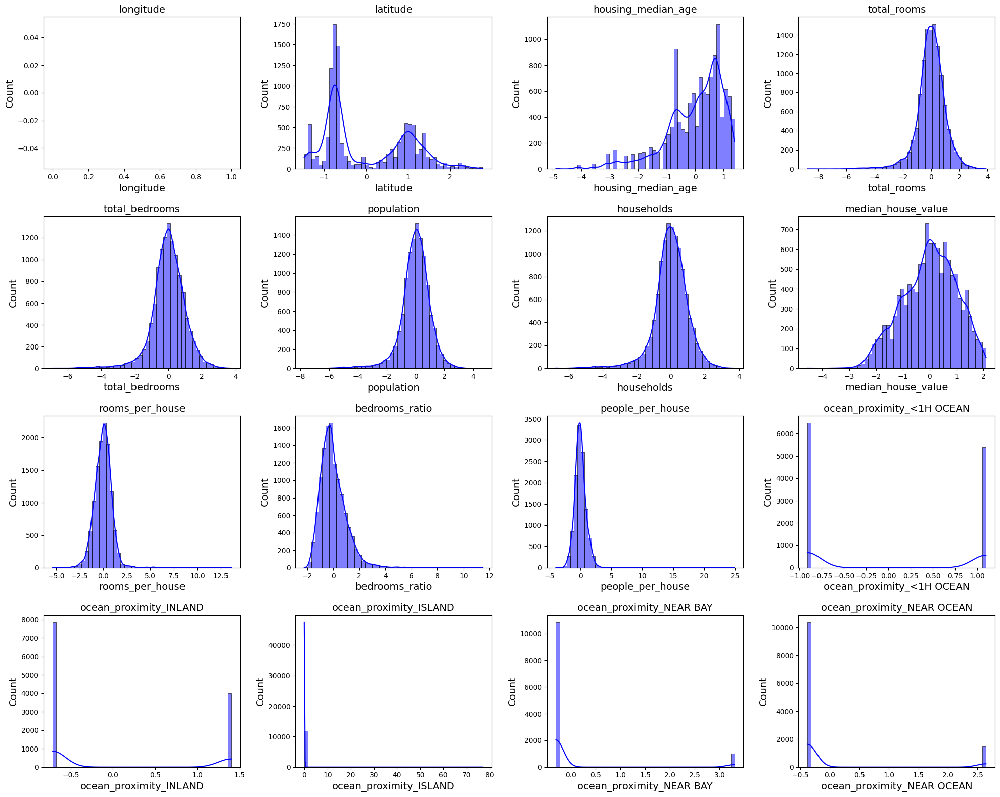

In [ ]:
# Llamar a la función para generar el histograma del archivo '1_X_entrenamiento_scaled.csv'
plot_and_save_histograms_from_csv("1_X_entrenamiento_scaled.csv")

***Histograma para 2_X_validacion_scaled.csv***

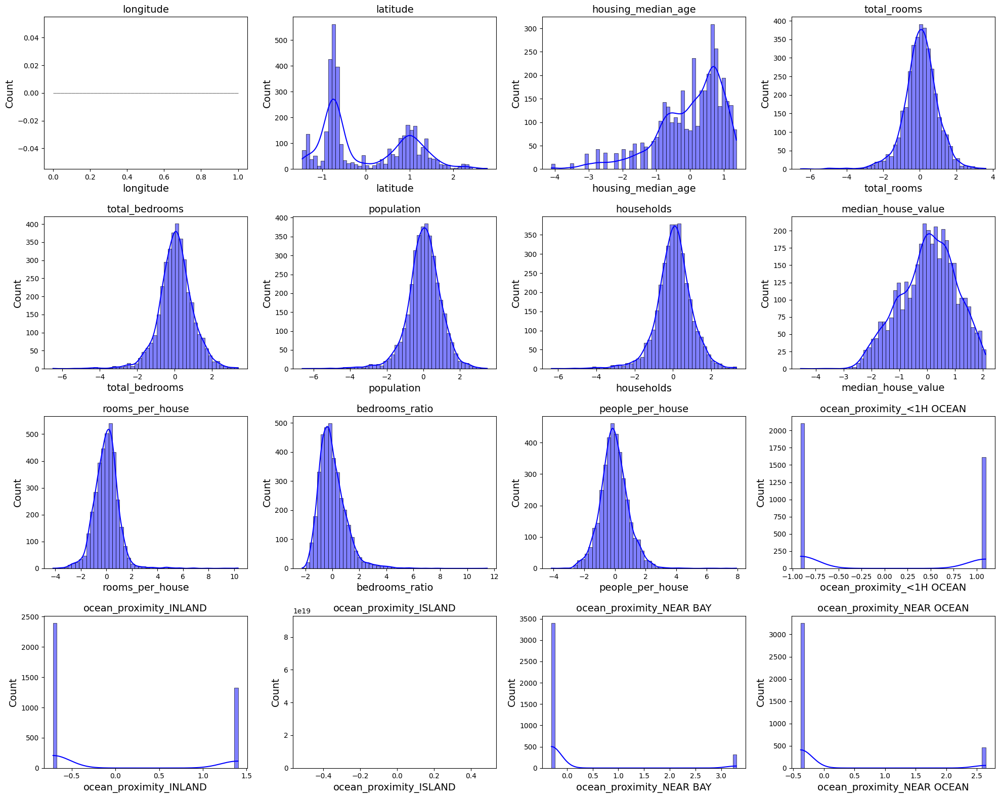

In [ ]:
# Llamar a la función para generar el histograma del archivo '2_X_validacion_scaled.csv'
plot_and_save_histograms_from_csv("2_X_validacion_scaled.csv")

***Histograma para 3_X_prueba_scaled.csv***

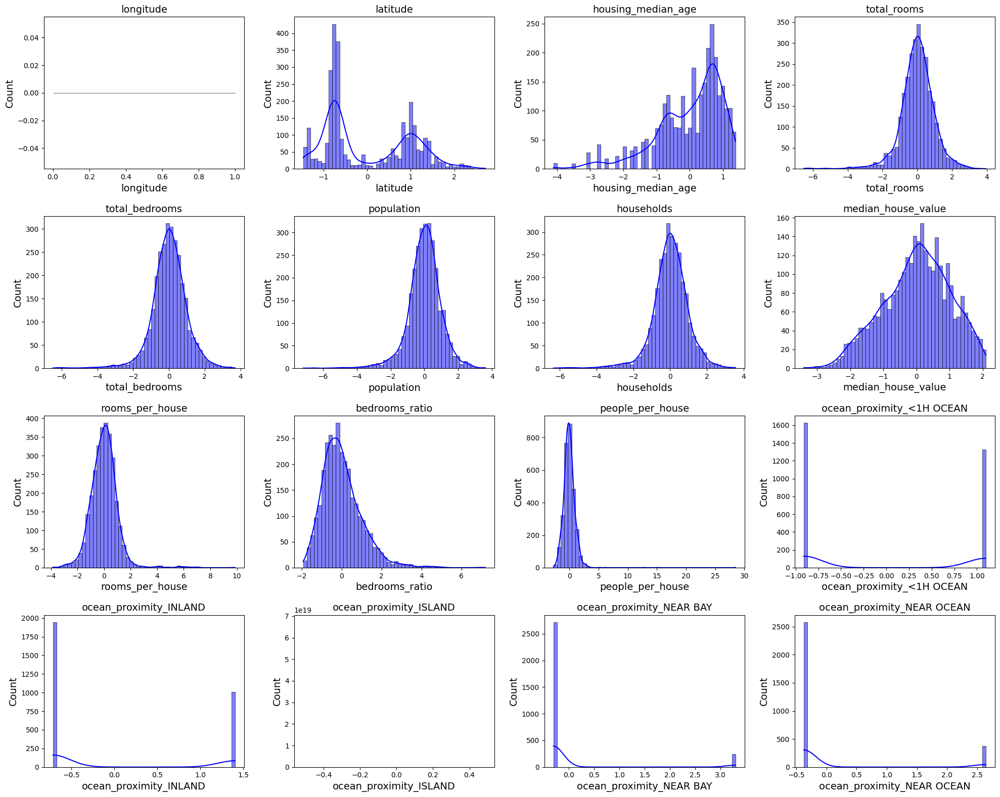

In [ ]:
# Llamar a la función para generar el histograma del archivo '3_X_prueba_scaled.csv'
plot_and_save_histograms_from_csv("3_X_prueba_scaled.csv")